In [22]:
%matplotlib inline
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
import os
pylab.rcParams['figure.figsize'] = (8.0, 10.0)

In [23]:
!ls multimodal-data/dataset_coco/

annotations.json  images


In [24]:
# dataDir = './multimodal-data/dataset_coco/'

# annFile = '/home/ivan/work/dino/data_vis/Grounding-Dino-FineTuning/multimodal-data/dataset_coco/annotations.json'
# coco_dt_path = '/home/ivan/work/dino/data_vis/Grounding-Dino-FineTuning/pred_coco.json'

In [25]:
dataDir = './multimodal-data/GAI20II_COCO/'
annFile = '/home/ivan/work/dino/data_vis/Grounding-Dino-FineTuning/multimodal-data/GAI20II_COCO/annotations.json'
coco_dt_path = '/home/ivan/work/dino/data_vis/Grounding-Dino-FineTuning/pred_coco.json'

In [26]:
# initialize COCO api for instance annotations
coco=COCO(annFile)

loading annotations into memory...
Done (t=0.10s)
creating index...
index created!


In [27]:
# display COCO categories and supercategories
cats = coco.loadCats(coco.getCatIds())
nms=[cat['name'] for cat in cats]
print('COCO categories: \n{}\n'.format(' '.join(nms)))

# nms = set([cat['supercategory'] for cat in cats])
# print('COCO supercategories: \n{}'.format(' '.join(nms)))

COCO categories: 
pliers pen screws vernier caliper tweezers usb cable measurement tape wire power supply wrench scissors drill cutter tape crimpers hammer hand file whiteboard marker screwdriver pendant control



In [28]:
def showAnns(anns, ax, color='red'):
    for i in anns:
        [bbox_x, bbox_y,bbox_w, bbox_h] = i['bbox']
        poly = [[bbox_x, bbox_y], [bbox_x, bbox_y+bbox_h], [bbox_x+bbox_w, bbox_y+bbox_h], [bbox_x+bbox_w, bbox_y]]
        np_poly = np.array(poly).reshape((4,2))
        ax.add_patch(Polygon(np_poly, linestyle='--', facecolor='none', edgecolor=color, linewidth=2))

In [29]:
# get all images containing given categories, select one at random
catIds = coco.getCatIds(catNms=['person','dog','skateboard']);
imgIds = coco.getImgIds(catIds=catIds );
print(imgIds)


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105]


In [30]:
cocoDt = coco.loadRes(coco_dt_path)

Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!


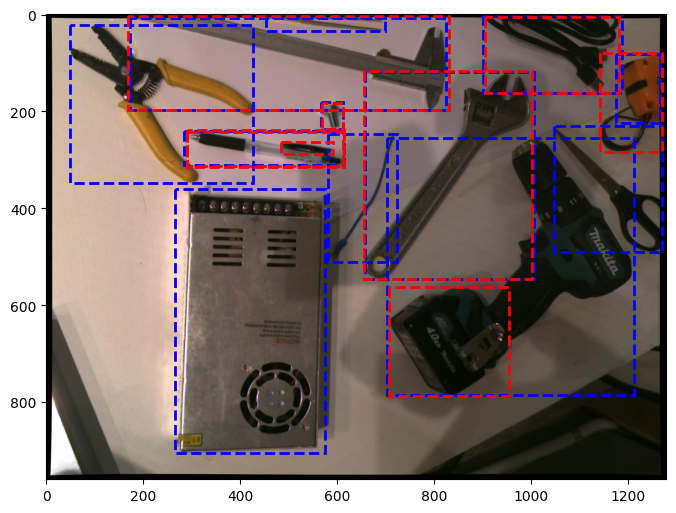

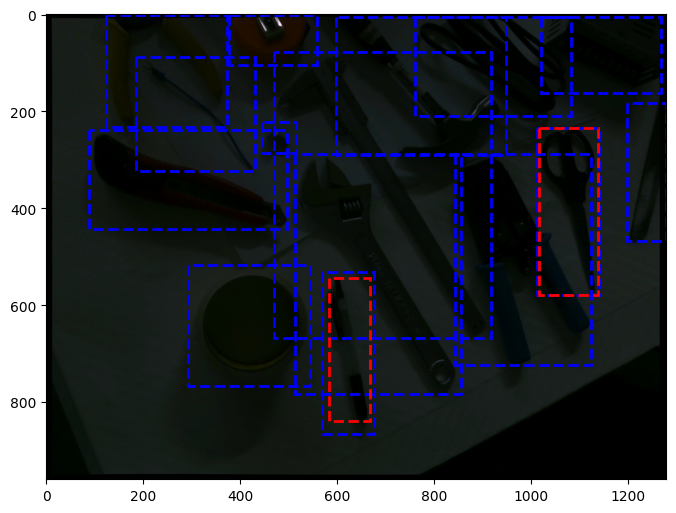

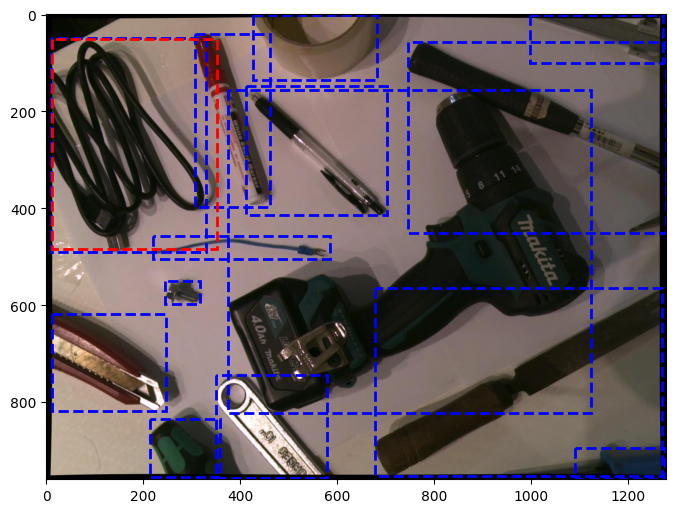

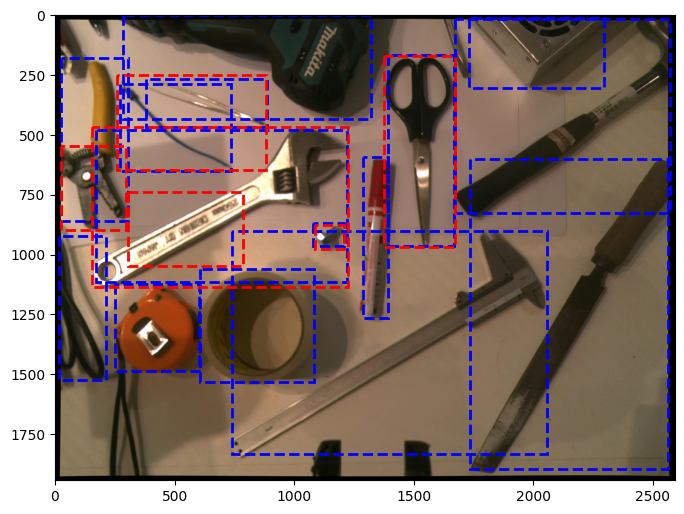

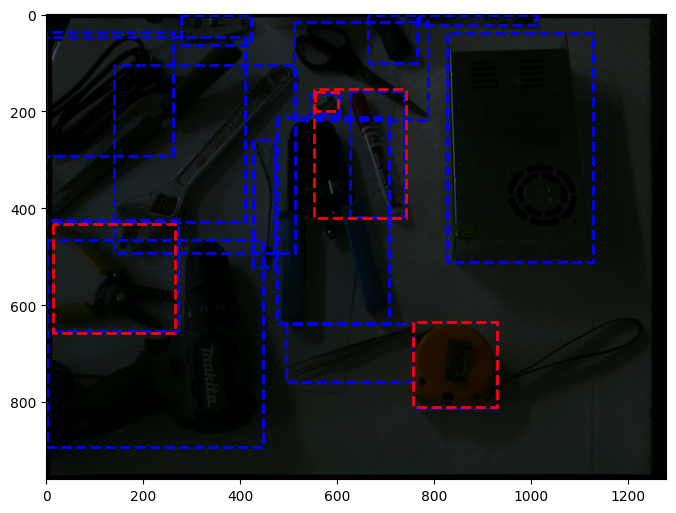

...

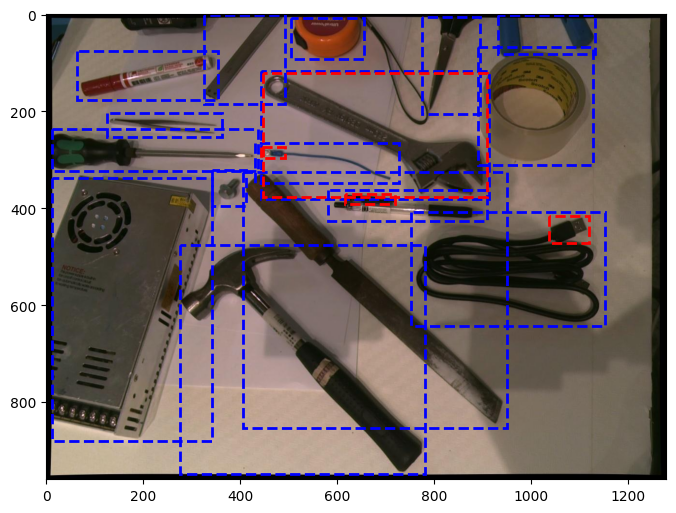

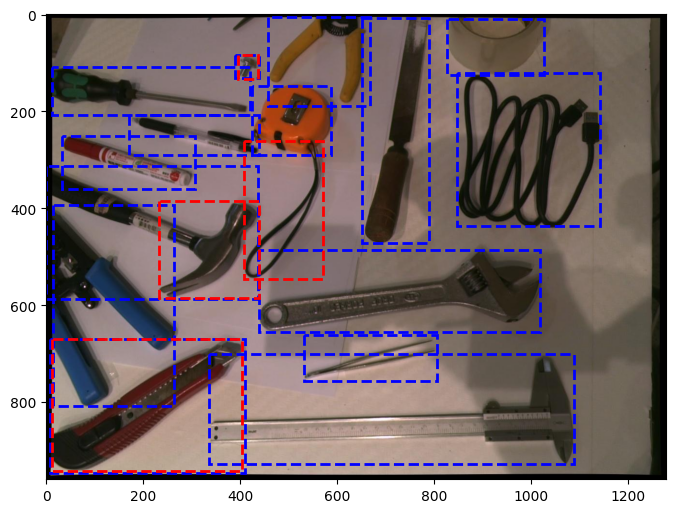

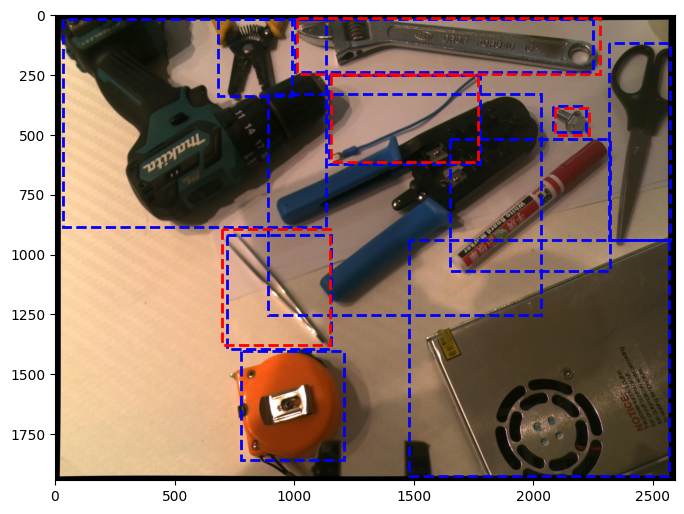

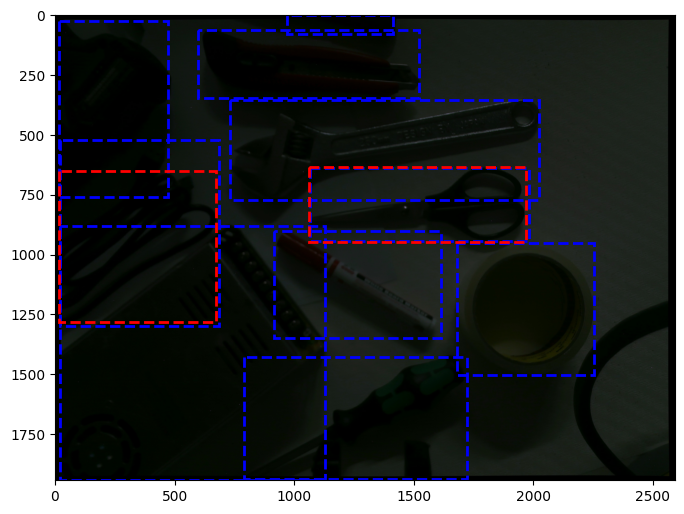

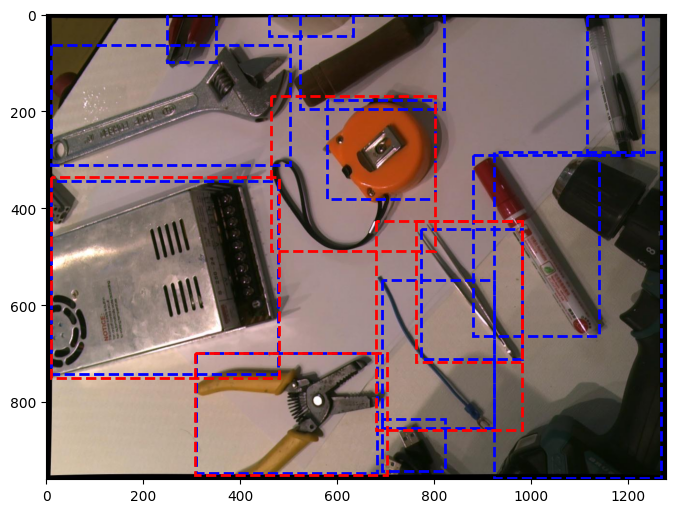

In [31]:
#img = coco.loadImgs(imgIds[np.random.randint(0,len(imgIds))])[0]
for _id in imgIds:
    # imgId = coco.getImgIds(imgIds = [_id])
    img_info = coco.loadImgs(_id)[0]
    # print(img_info)

    impath = os.path.join(dataDir, 'images', img_info['file_name'])
    I = io.imread(impath)

    from matplotlib.patches import Polygon
    # load and display instance annotations
    fig, ax = plt.subplots(1,1)
    ax.imshow(I); #plt.axis('off')
    
    annIds = coco.getAnnIds(imgIds=img_info['id'], catIds=catIds, iscrowd=None)
    anns = coco.loadAnns(annIds)
    showAnns(anns, ax, 'blue')
    
    annIds = cocoDt.getAnnIds(imgIds=img_info['id'], catIds=catIds, iscrowd=None)
    anns = cocoDt.loadAnns(annIds)
    # anns = coco.loadAnns(annIds)
    showAnns(anns, ax, 'red')
    
    plt.show()